In [2]:
import numpy as np
import skimage as sk
import scipy
import skimage.io as skio
import math
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import cv2
import json
import skim as ski

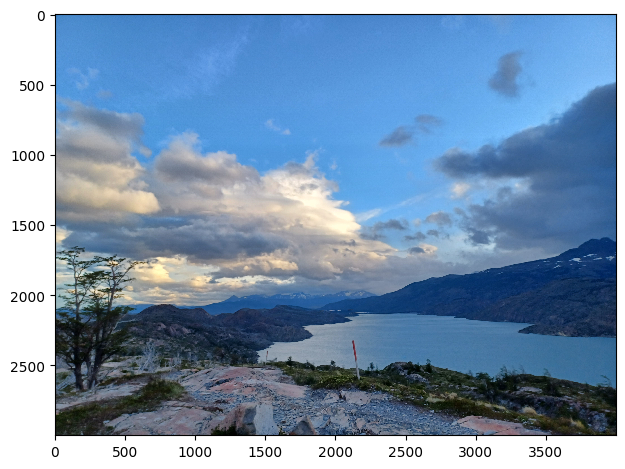

In [3]:
lake1 = skio.imread('lake1.jpg')
lake2 = skio.imread('lake2.jpg')
skio.imshow(lake1)

In [4]:
import scipy.spatial



with open('im1_im2.json', 'r') as file:
    data = json.load(file)
im1Points=data["im1Points"]
im2Points=data["im2Points"]

# print(im1Points)


In [5]:
import cv2
import numpy as np

def resize_image_and_points(image, points, new_size):

    resized_image = cv2.resize(image, new_size)

    original_height, original_width = image.shape[:2]

    scale_x = new_size[0] / original_width
    scale_y = new_size[1] / original_height

    scale_factors = np.array([scale_x, scale_y])
    resized_points = points * scale_factors 

    return resized_image, resized_points



In [6]:
print(lake1.shape)
lake1, im1Points = resize_image_and_points(lake1, im1Points, (800,600))
lake2, im2Points = resize_image_and_points(lake2, im2Points, (800,600))



(3000, 4000, 3)


In [7]:

import numpy as np
from skimage.feature import corner_harris, peak_local_max


def get_harris_corners(im, edge_discard=20):
    """
    This function takes a b&w image and an optional amount to discard
    on the edge (default is 5 pixels), and finds all harris corners
    in the image. Harris corners near the edge are discarded and the
    coordinates of the remaining corners are returned. A 2d array (h)
    containing the h value of every pixel is also returned.

    h is the same shape as the original image, im.
    coords is 2 x n (ys, xs).
    """

    assert edge_discard >= 20

    # find harris corners
    h = corner_harris(im, method='eps', sigma=1)
    coords = peak_local_max(h, min_distance=1)

    # discard points on edge
    edge = edge_discard  # pixels
    mask = (coords[:, 0] > edge) & \
           (coords[:, 0] < im.shape[0] - edge) & \
           (coords[:, 1] > edge) & \
           (coords[:, 1] < im.shape[1] - edge)
    coords = coords[mask].T
    return h, coords


def dist2(x, c):
    """
    dist2  Calculates squared distance between two sets of points.

    Description
    D = DIST2(X, C) takes two matrices of vectors and calculates the
    squared Euclidean distance between them.  Both matrices must be of
    the same column dimension.  If X has M rows and N columns, and C has
    L rows and N columns, then the result has M rows and L columns.  The
    I, Jth entry is the  squared distance from the Ith row of X to the
    Jth row of C.

    Adapted from code by Christopher M Bishop and Ian T Nabney.
    """
    
    ndata, dimx = x.shape
    ncenters, dimc = c.shape
    assert(dimx == dimc, 'Data dimension does not match dimension of centers')

    return (np.ones((ncenters, 1)) * np.sum((x**2).T, axis=0)).T + \
            np.ones((   ndata, 1)) * np.sum((c**2).T, axis=0)    - \
            2 * np.inner(x, c)



<>:50: SyntaxWarning: assertion is always true, perhaps remove parentheses?
<>:50: SyntaxWarning: assertion is always true, perhaps remove parentheses?
C:\Users\Jae\AppData\Local\Temp\ipykernel_20300\2230188303.py:50: SyntaxWarning: assertion is always true, perhaps remove parentheses?
  assert(dimx == dimc, 'Data dimension does not match dimension of centers')


In [8]:

# skio.imshow(lake1)
harris1, coords1=get_harris_corners(lake1[:,:,1],edge_discard=20)
harris2, coords2=get_harris_corners(lake2[:,:,1], edge_discard=20)



In [9]:
print(harris1.shape)
print(coords1.shape)

(600, 800)
(2, 12714)


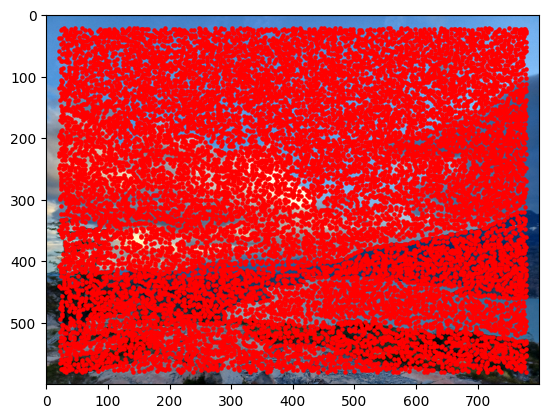

In [10]:
plt.imshow(lake1)
plt.scatter(coords1[1], coords1[0], c='r', s=5)
plt.show()

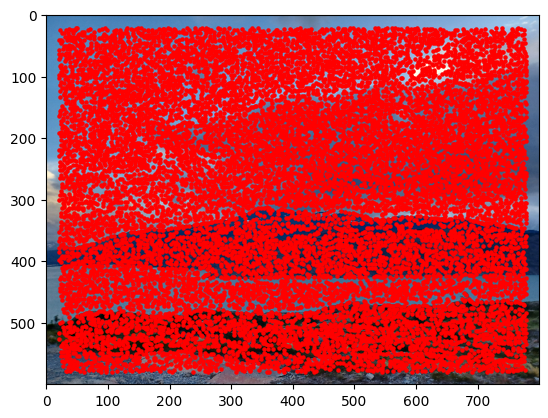

In [11]:
plt.scatter(coords2[1], coords2[0], c='r', s=5)
plt.imshow(lake2)
plt.show()

In [229]:
def adaptive_non_maximal_suppression(h, coord, num, c_robust=0.9):
    points = [[coord[0].tolist(), h[0], 0]] 

    dist = dist2(coord, coord)
    
    r_i = np.inf  

    for i in range(1,len(h)): 
        x = coord[i, :].tolist()  

        suppressed = False
        for j in range(len(points)):  
            xj, hj, j = points[j]
            if h[i] < c_robust * hj: 
                d = dist[i, j] 
                if d < r_i:  
                    suppressed = True
                    r_i = min(r_i, d)  

                    break  
                

        if not suppressed:
            # plt.imshow(lake1)
            # plt.scatter(coord[i, 1], coord[i, 0], c='r', s=5)
            points.append([x, h[i], i])  # Append new point with its strength

    points = [{"coordinates": point[0], "h": point[1], "index": point[2]} for point in points]
    ret = [point['coordinates'] for point in points[:num]]
    return np.array(ret)

# Example usage
# ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 500)
# for item in ANMS1:
#     print(item)
# print(ANMS1)

[[393  61]
 [373  30]
 [356  88]
 ...
 [530 294]
 [372  54]
 [561 376]]


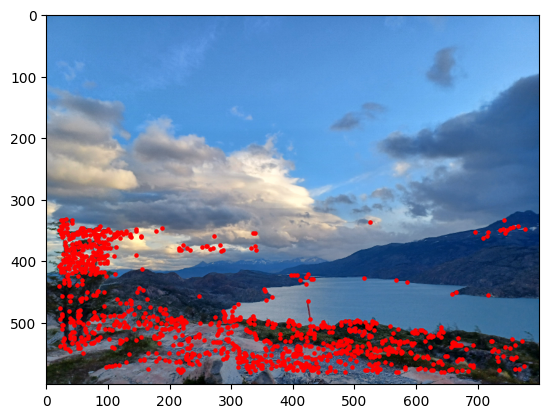

In [231]:
ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
print(ANMS1)
plt.imshow(lake1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()

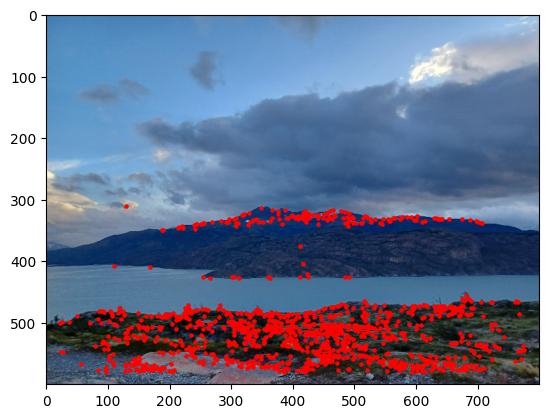

In [232]:
ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
plt.imshow(lake2)
plt.scatter(ANMS2[:,1],ANMS2[:,0], c='r', s=5)
plt.show()

 Don’t worry about rotation-invariance – just extract axis-aligned 8x8 patches. Note that it’s extremely important to sample these patches from the larger 40x40 window to have a nice big blurred descriptor. Don’t forget to bias/gain-normalize the descriptors. Ignore the wavelet transform section. 

In [386]:
import numpy as np
from scipy.ndimage import zoom
import cv2
import scipy.signal

def feature_descr(im, points):

    gaussian_kernel_1d = cv2.getGaussianKernel(40, 3)
    gaussian_kernel_2d = np.outer(gaussian_kernel_1d, gaussian_kernel_1d)
    im_blur = scipy.signal.convolve2d(im, gaussian_kernel_2d, mode='same')

    n_points = points.shape[0]
    descriptors = np.zeros((n_points, 8* 8))
    coordinates = np.zeros((n_points, 2)) 

    half_size = 40// 2
    spacing = 40// 8

    for i in range(n_points):
        y, x = points[i, :]

        coordinates[i] = (y, x)

        window = im_blur[y - half_size : y + half_size, x - half_size : x + half_size]
        sampled_patch = window[::spacing, ::spacing]

        vec = sampled_patch.flatten()
        mean = np.mean(vec)
        std = np.std(vec)
        if std > 1e-6:
            vec_normalized = (vec - mean) / std
        else:
            vec_normalized = vec - mean  

        descriptors[i] = vec_normalized
    descriptors=(descriptors-np.mean(descriptors))/np.std(descriptors)

    return descriptors, coordinates


(1000, 2)
[ 1.08673481  0.80703092 -0.48522084 -0.98860725 -0.69242592 -0.64898295
 -0.72180156 -0.81750574  1.26644711  1.03499798  0.12788691 -0.62579808
 -0.8806295  -0.63553133 -1.0343676  -1.44702815  1.00945249  0.82700454
  0.32996332 -0.05268816 -0.13448942  0.06046886 -0.40700007 -0.41414899
  1.13396234  1.0668452   0.96311701  0.57774706  0.26810192  0.56853328
  0.59472559  0.13965332  1.62776126  1.49809848  1.50202598  1.08971513
  0.25209679  0.01762108 -0.53539027 -1.78901095  1.42861034  1.41043405
  1.35900023  0.93639514 -0.56346903 -1.05837341 -1.45722321 -2.05754983
  1.17801185  0.9453859   0.80217874  0.52621026 -0.85657814 -1.47757013
 -2.15310556 -1.77507878  0.70442433  0.41227288  0.088345   -0.12044351
 -0.85481746 -0.68655873 -1.16667108 -1.10319445]


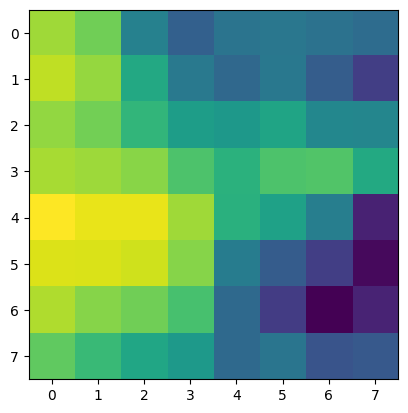

In [387]:
print(ANMS1.shape)
feat1,coord1f=feature_descr(lake1[:,:,1], ANMS1)
feat2, coord2f=feature_descr(lake2[:,:,1], ANMS2)

print(feat1)
plt.imshow(feat1[1].reshape(8,8))



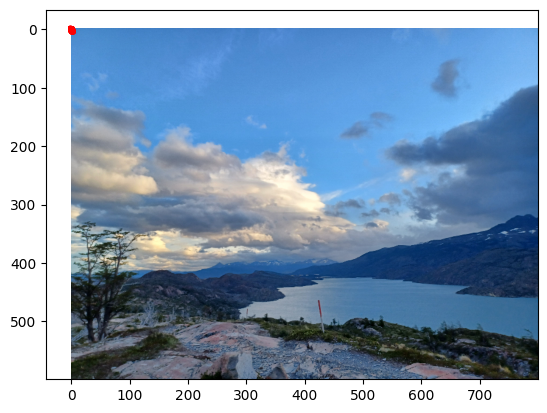

In [220]:
feat1, coord1f = feature_descr(lake1[:,:,1], ANMS1)
plt.imshow(lake1)
for f in feat1:
    plt.scatter(f[1], f[0], c='r', s=5)

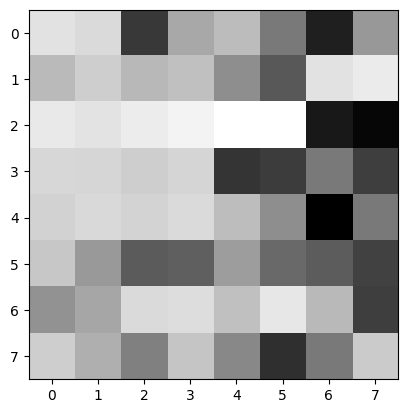

In [119]:
plt.imshow(feat1[5],cmap='gray')


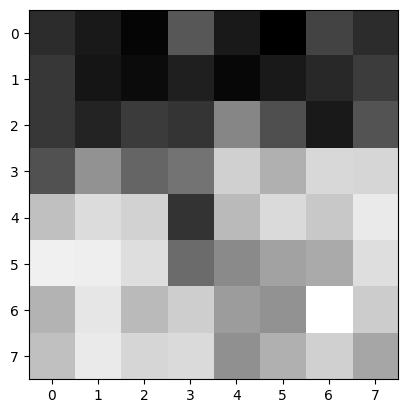

In [120]:
plt.imshow(feat1[90],cmap='gray')


In [266]:
def feature_match1(feat1,feat2, thresh=0.8):
    matches = []
    distances = scipy.spatial.distance.cdist(feat1.reshape(feat1.shape[0], -1), feat2.reshape(feat2.shape[0], -1), 'euclidean')

    for i in range(feat1.shape[0]):
        sorted_indices = np.argsort(distances[i])
        nn1_index = sorted_indices[0]
        nn2_index = sorted_indices[1]
        nn1_distance = distances[i, nn1_index]
        nn2_distance = distances[i, nn2_index]

        if nn1_distance / nn2_distance < thresh:
            matches.append((i, nn1_index))

    return matches

In [267]:
def feature_match(feat1,feat2,thresh=0.8):

    matches = []
    
    distances = scipy.spatial.distance.cdist(feat1.reshape(feat1.shape[0], -1), 
                                              feat2.reshape(feat2.shape[0], -1), 
                                              'euclidean')
    
    for i in range(feat1.shape[0]):
        nn1_index = np.argmin(distances[i])
        nn1_distance = distances[i, nn1_index]
        
        second_distances = distances[i].copy()
        second_distances[nn1_index] = float('inf')
        nn2_index = np.argmin(second_distances)
        nn2_distance = second_distances[nn2_index]

        if nn1_distance / nn2_distance < thresh:
            matches.append((i, nn1_index))
    
    return matches

In [268]:
print(feat1.shape)
matches = feature_match(feat1, feat2, 0.85)


(1000, 8, 8)


In [575]:
ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
feat1,coord1f=feature_descr(lake1[:,:,1], ANMS1)
feat2,coord2f=feature_descr(lake2[:,:,1], ANMS2)
matches = feature_match(feat1, feat2, thresh=0.6)
print(matches)
print(len(matches))

[(202, 57), (268, 19), (300, 477), (334, 446), (375, 152), (418, 817), (588, 298), (688, 951), (719, 828), (745, 762), (761, 143), (815, 762), (831, 546), (971, 181), (973, 948), (983, 768)]
16


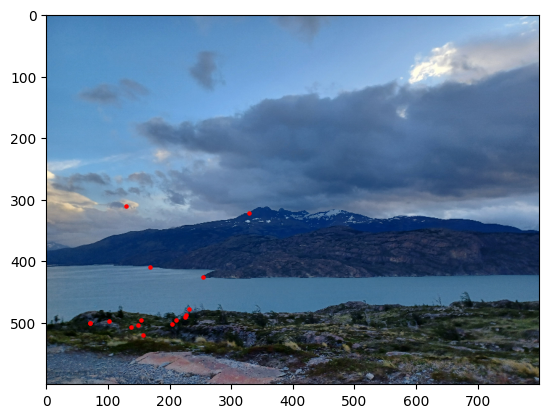

In [576]:
plt.imshow(lake2)
for m in matches:
    x,y=coord2f[m[1]]
    # print(x,y)
    plt.scatter(y,x, c='r', s=5)
# plt.scatter(coord1f], c='r', s=5)
plt.show()

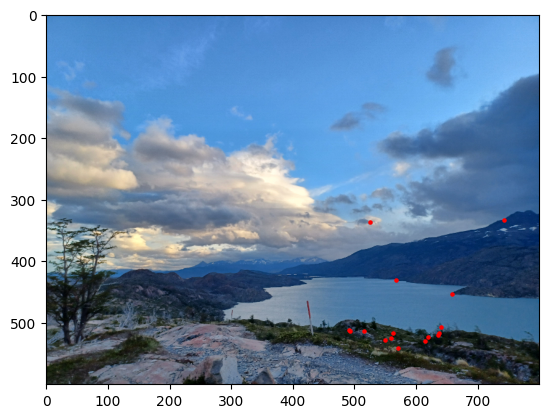

In [577]:
plt.imshow(lake1)
for m in matches:
    x,y=coord1f[m[0]]
    # print(x,y)
    plt.scatter(y,x, c='r', s=5)
# plt.scatter(coord1f], c='r', s=5)
plt.show()

In [408]:
def match_features(descriptors1, descriptors2, ratio_threshold=0.8):
    if descriptors1.size == 0 or descriptors2.size == 0:
        return []

    dist = dist2(descriptors1, descriptors2) 
    sorted_indices = np.argsort(dist, axis=1)

    near = sorted_indices[:, 0]  
    second_near = sorted_indices[:, 1]  

    neardist = dist[np.arange(dist.shape[0]), near]
    second_neardist = dist[np.arange(dist.shape[0]), second_near]

    ratio = neardist / (second_neardist + 1e-10)
    mask = ratio < ratio_threshold

    matches = []
    for i in range(len(mask)):
        if mask[i]:
            matches.append((i, near[i]))

    return np.array(matches)

In [530]:
import numpy as np

def computeH(im1_pts_list, im2_pts_list):
    im1_pts = np.array(im1_pts_list)
    im2_pts = np.array(im2_pts_list)

    
    n = im1_pts.shape[0]
    A = []

    for i in range(n):
        x, y = im1_pts[i, 0], im1_pts[i, 1]
        x_prime, y_prime = im2_pts[i, 0], im2_pts[i, 1]
        
        A.append([-x, -y, -1, 0, 0, 0, x * x_prime, y * x_prime, x_prime])
        A.append([0, 0, 0, -x, -y, -1, x * y_prime, y * y_prime, y_prime])

    A = np.array(A)
    
    _, _, Vt = np.linalg.svd(A)
    h = Vt[-1]  

    H = h.reshape(3, 3)

    H =H/ H[2, 2]

    return H


In [605]:

def ransac(coords1, coords2):
    best_h = None
    best_inliers = 0
    for _ in range(1000):
        coords1reshaped = coords1.reshape(-1)
        coords2reshaped = coords2.reshape(-1)
        print("COORDRESHAPED",coords1reshaped.shape)
        # print(coords1reshaped.shape)
        sample1= np.random.choice(coords1.shape[1], 4, replace=False)

        # print(sample1)
        # sample = np.random.choice(coords1.shape[1], 4, replace=False)
        # print(sample1.shape)
        print("sample1",sample1)
        
        print("coords",coords1[:,sample1].shape)
        h = computeH(coords1[:,sample1].T, coords2[:,sample1].T)
        inliers = 0
        
        for j in range(coords1.shape[0]):
            print("J",j)
            print("AAAAH",coords1[j])
            x, y = coords1[j]
            xp, yp = coords2[j]
            p = np.array([x, y, 1])
            p_prime = np.dot(h, p)
            p_prime /= p_prime[2]
            dist = np.linalg.norm(p_prime[:2] - np.array([xp, yp]))
            if dist < 5:
                inliers += 1
        if inliers > best_inliers:
            best_inliers = inliers
            best_h = h
    return best_h, best_inliers


# # print(coords1ff.shape)  

# ransac_H, ransac_inliers = ransac(coords1ff, coords2ff)

# print(ransac_H)
# print(ransac_inliers)

In [546]:
# print(np.array(matches).shape)
# ransac1=[]
# ransac2=[]
# for m in matches:
#     print(m)
#     ransac1.append(coord1f[matches[:,0]][:,1], coord1f[matches[:,0]][:,0])
#     break
    # print(ransac1)
    # ransac2=[coord2f[matches[:,1]][:,1], coord2f[matches[:,1]][:,0]]
    # print(ransac1)


coords1ff=coord1f[matches[:,0]]
# print(matches.shape)
coords2ff=coord2f[matches[:,1]]
coords1ff=coords1ff.T
coords2ff=coords2ff.T
coords1ff=np.array(coords1ff)
coords2ff=np.array(coords2ff)
print(coords1ff.shape)  



ransac_H, ransac_inliers = ransac(coords1ff, coords2ff)

print(ransac_H)
print(ransac_inliers)

(2, 158)
COORDRESHAPED (316,)
sample1 [154  60 135  33]
coords (2, 4)
[495. 356. 565. 346. 496. 396. 360. 401. 354. 503. 503. 576. 469. 357.
 355. 354. 505. 490. 522. 541. 431. 498. 507. 358. 505. 474. 519. 578.
 456. 520. 496. 453. 521. 391. 549. 512. 541. 546. 509. 521. 546. 568.
 523. 526. 556. 417. 577. 577. 520. 531. 502. 573. 514. 567. 549. 529.
 508. 544. 545. 513. 529. 493. 530. 535. 559. 566. 530. 561. 539. 525.
 564. 550. 572. 512. 355. 575. 530. 559. 576. 579. 552. 536. 575. 579.
 548. 521. 547. 517. 352. 533. 512. 392. 535. 546. 526. 556. 530. 536.
 357. 523. 572. 542. 517. 516. 519. 531. 536. 575. 454. 527. 500. 503.
 549. 577. 512. 546. 577. 534. 333. 347. 509. 539. 523. 508. 507. 506.
 513. 336. 550. 553. 576. 498. 376. 556. 517. 546. 449. 379. 529. 427.
 530. 569. 577. 553. 354. 574. 496. 564. 550. 531. 555. 579. 506. 525.
 507. 529. 345. 372.]


ValueError: too many values to unpack (expected 2)

(16, 2)
16


TypeError: 'int' object is not iterable

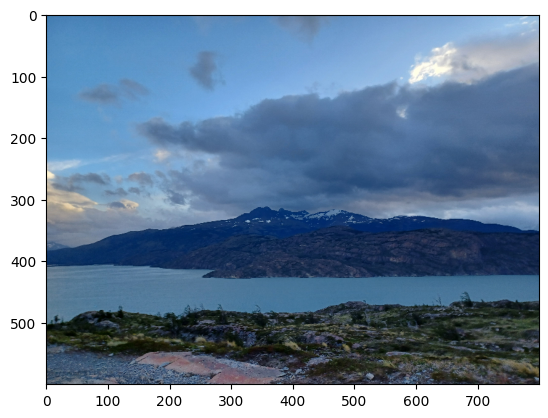

In [612]:
def ransac(coord1,coord2):
    best_H = None
    best_inliers =0
    for _ in range(1000):
        # print(coord1.shape[0])
        sample = np.random.choice(coord1.shape[0], 4, replace=False)
        h = computeH(coord1[sample,:], coord2[sample,:])
        inliers = 0
        for j in range(coord1.shape[0]):
            # print(j)
            x, y = coord1[j,:]
            xp, yp = coord2[j,:]
            p = np.array([x, y, 1])
            p_prime = np.dot(h, p)
            p_prime /= p_prime[2]
            dist = np.linalg.norm(p_prime[:2] - np.array([xp, yp]))
            if dist < 5:
                inliers += 1
        if inliers > best_inliers:
            best_inliers = inliers
            best_H = h
    return best_H, best_inliers

print(coords1ff[:,[1,0]].shape)
ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords1ff[:,[1,0]])
plt.imshow(lake2)
print(ransac_inliers)
for i in ransac_inliers:
    x, y = coord2f[i]
    plt.scatter(y, x, c='r', s=5)
plt.show()
plt.imshow(lake1)
for i in ransac_inliers:
    x, y = coord1f[i]
    plt.scatter(y, x, c='r', s=5)
plt.show()

(16, 2)
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


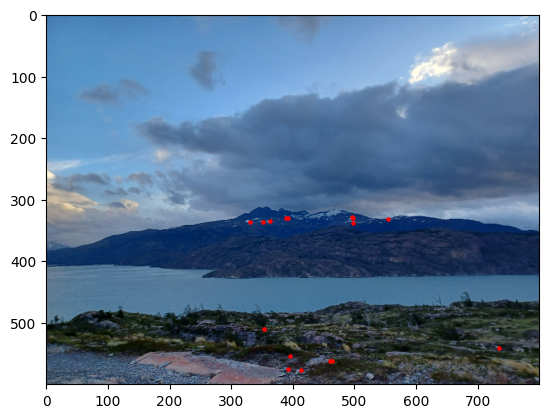

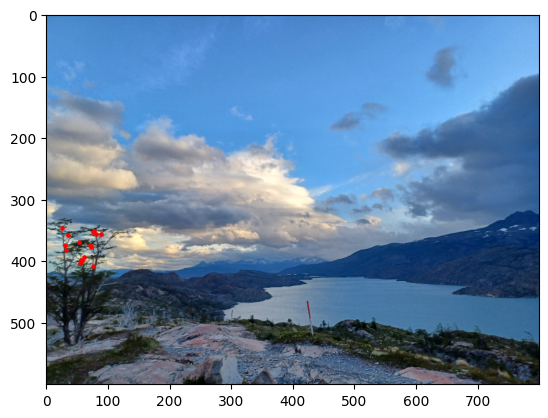

In [619]:
def ransac(coords1,coords2,epsilon=0.5):
    best_H = None
    best_inliers = []

    for _ in range(1000):
        pointss = np.random.choice(coords1.shape[0], 4, replace=False)
        coordss = coords1[pointss]
        coordss2 = coords2[pointss]

        H = computeH(coordss, coordss2)

        inliers = []
        for i in range(coords1.shape[0]):
            p1 = np.append(coords1[i], 1)
            p2 = np.append(coords2[i], 1)
            p2_estimated = np.dot(H, p1)
            p2_estimated /= p2_estimated[2]

            dist = np.linalg.norm(p2[:2] - p2_estimated[:2])
            if dist < epsilon:
                inliers.append(i)

        if len(inliers) > len(best_inliers):
            best_inliers = inliers
            best_H = H
    if best_inliers:
        best_coords1 = coords1[best_inliers]
        best_coords2 = coords2[best_inliers]
        best_H = computeH(best_coords1, best_coords2)

    return best_H, best_inliers

print(coords1ff[:,[1,0]].shape)
ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords1ff[:,[1,0]])
plt.imshow(lake2)
print(ransac_inliers)
for i in ransac_inliers:
    x, y = coord2f[i]
    plt.scatter(y, x, c='r', s=5)
plt.show()
plt.imshow(lake1)
for i in ransac_inliers:
    x, y = coord1f[i]
    plt.scatter(y, x, c='r', s=5)
plt.show()

TypeError: 'int' object is not iterable

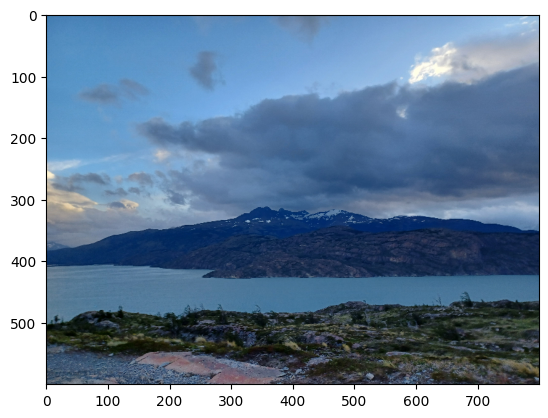

In [590]:
ransac_H, ransac_inliers = ransac(coord1f[matches[:, 0]].T, coord2f[matches[:, 1]].T)
plt.imshow(lake2)
for i in ransac_inliers:
    x, y = coord2f[i]
    plt.scatter(y, x, c='r', s=5)
plt.show()
plt.imshow(lake1)
for i in ransac_inliers:
    x, y = coord1f[i]
    plt.scatter(y, x, c='r', s=5)
plt.show()

In [680]:
import numpy as np
import scipy.interpolate
from scipy import ndimage

def blend(img1: np.ndarray, img2: np.ndarray) -> np.ndarray:
    dist1 = ndimage.distance_transform_edt(img1[:, :, 0] > 0)
    dist2 = ndimage.distance_transform_edt(img2[:, :, 0] > 0)
    alpha_mask = dist1 / (dist1 + dist2 + 1e-2)
    alpha_mask = np.expand_dims(alpha_mask, axis=2)
    out_img = img1 * alpha_mask + img2 * (1 - alpha_mask)
    return out_img

def bound(width, height, H):
    corners = np.array([[0, 0, 1],
                        [width, 0, 1],
                        [0, height, 1],
                        [width, height, 1]])
    trans = np.dot(H, corners.T)
    trans = trans.T
    trans /= trans[:, 2].reshape(-1, 1)
    x_coords = trans[:, 0]
    y_coords = trans[:, 1]
    min_x, max_x = np.min(x_coords), np.max(x_coords)
    min_y, max_y = np.min(y_coords), np.max(y_coords)
    return min_x, max_x, min_y, max_y

def warp_image(warp_image, to_image, H):
    h_warp, w_warp, channels = warp_image.shape
    h_to, w_to, _ = to_image.shape

    min_x_warp, max_x_warp, min_y_warp, max_y_warp = bound(w_warp, h_warp, H)
    min_x_to, max_x_to, min_y_to, max_y_to = 0, w_to, 0, h_to

    x_min = int(np.floor(min(min_x_warp, min_x_to)))
    x_max = int(np.ceil(max(max_x_warp, max_x_to)))
    y_min = int(np.floor(min(min_y_warp, min_y_to)))
    y_max = int(np.ceil(max(max_y_warp, max_y_to)))

    mosaic_width = x_max - x_min
    mosaic_height = y_max - y_min

    transx = -x_min if x_min < 0 else 0
    transy = -y_min if y_min < 0 else 0
    translation = np.array([[1, 0, transx],
                            [0, 1, transy],
                            [0, 0, 1]])
    homog = np.dot(translation, H)

    mosaic = np.zeros((mosaic_height, mosaic_width, channels + 1), dtype=warp_image.dtype)

    mosaic[transy:transy + h_to, transx:transx + w_to, :channels] = to_image
    mosaic[transy:transy + h_to, transx:transx + w_to, 3] = 255

    y_mosaic, x_mosaic = np.indices((mosaic_height, mosaic_width))
    coordm = np.stack([x_mosaic.ravel(), y_mosaic.ravel(), np.ones_like(x_mosaic).ravel()])

    homog_i = np.linalg.inv(homog)
    coords_original = np.dot(homog_i, coordm)
    coords_original /= coords_original[2, :]
    x_orig, y_orig = coords_original[:2, :]

    original_x, original_y = np.arange(w_warp), np.arange(h_warp)

    imwarp = []
    for c in range(channels):
        interpolator = scipy.interpolate.RegularGridInterpolator((original_y, original_x), warp_image[..., c], method="linear", bounds_error=False, fill_value=0)
        points = np.vstack([y_orig, x_orig]).T
        wrap = interpolator(points).reshape(mosaic_height, mosaic_width)
        imwarp.append(wrap)

    warped_image = np.stack(imwarp, axis=-1)

    blend = blend(warped_image, mosaic[..., :channels])
    mosaic[..., :channels] = blend
    mosaic[..., 3] = 255  

    return mosaic


In [392]:
# for m in matches:
#     plt.imshow(lake1)
#     x,y=coord1f[m[0]]
#     plt.scatter(y,x, c='r', s=5)
#     plt.show()
#     plt.imshow(lake2)
#     x,y=coord2f[m[0]]
#     plt.scatter(y,x, c='r', s=5)
#     plt.show()


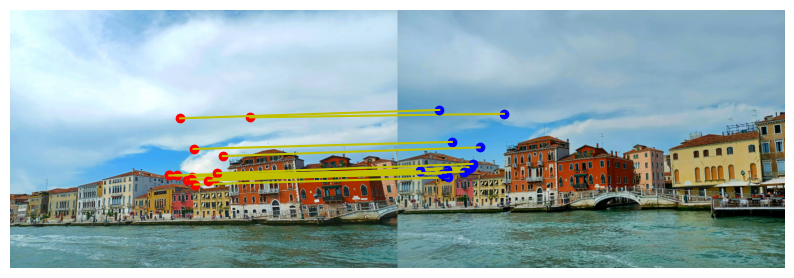

<Figure size 640x480 with 0 Axes>

In [642]:
def plot_correspondences(img1, img2, points1, points2):
    combined_image = np.concatenate((img1, img2), axis=1)
    
    plt.figure(figsize=(10, 5))
    plt.imshow(combined_image, cmap='gray')
    
    offset = img1.shape[1]
    
    for p1, p2 in zip(points1, points2):
        plt.plot(p1[1], p1[0], 'ro')  
        plt.plot(p2[1] + offset, p2[0], 'bo')  
        plt.plot([p1[1], p2[1] + offset], [p1[0], p2[0]], 'y-')  

    plt.axis("off")
    plt.show()
    plt.savefig('corresp.png')
# for m in matches:

plot_correspondences(lake1, lake2, coord1f[matches[:50,0]], coord2f[matches[:50,1]])

TypeError: list indices must be integers or slices, not tuple

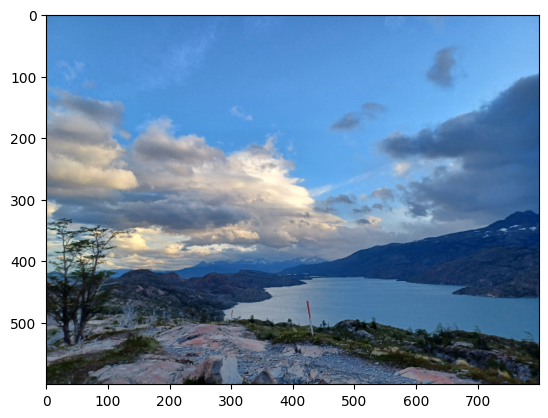

In [578]:
plt.imshow(lake1)
plt.plot(coord1f[matches[:,0]][:,1], coord1f[matches[:,0]][:,0], 'ro')
plt.show()

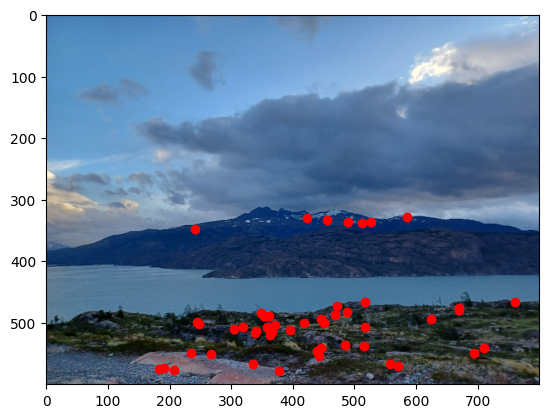

In [428]:
plt.imshow(lake2)
plt.plot(coord2f[matches[:50,0]][:,1], coord2f[matches[:50,0]][:,0], 'ro')
plt.show()

(1000, 2)


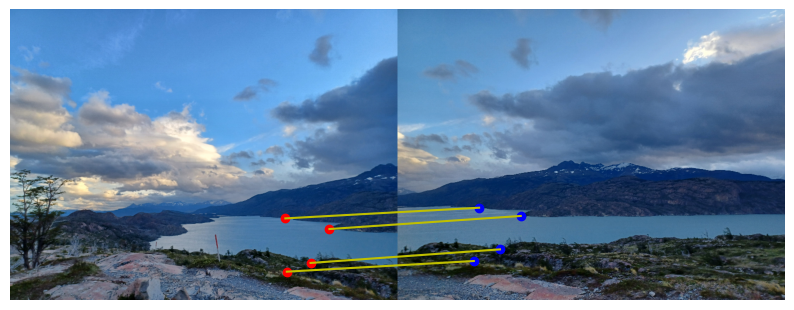

(16, 2)


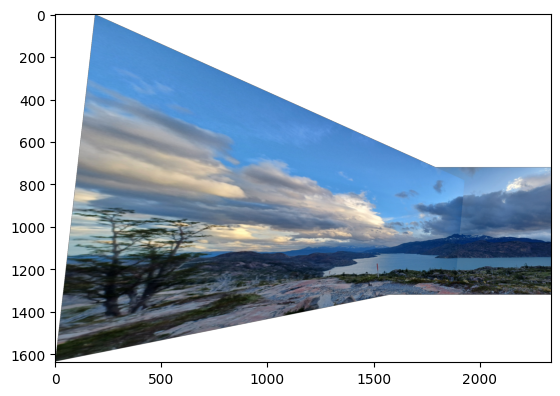

In [587]:
# print(matches.shape)
print(coord1f.shape)
# ransac_H=ransac(coord1f, coord2f)
# plt.imshow(lake2)
# for i in range(4):
#     print("i",i)
#     x, y = coord2f[matches[i,1]]
#     plt.scatter(y, x, c='r', s=5)

# plt.show()
# plt.imshow(lake1)
# for i in range(4):
#     print("i",i)
#     x, y = coord1f[matches[i,0]]

# coords1ff=coord1f[matches[:,0]]
# # print(matches.shape)
# coords2ff=coord2f[matches[:,1]]
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T
# coords1ff=np.array(coords1ff)
# coords2ff=np.array(coords2ff)
# print(coords1ff.shape)  

#     plt.scatter(y, x, c='r', s=5)
matches=np.array(matches)
plot_correspondences(lake1, lake2, coord1f[matches[:4,0]], coord2f[matches[:4,1]])
print(coord1f[matches[:,0]].shape)

coords1ff=coord1f[matches[:,0]]
coords2ff=coord2f[matches[:,1]]
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T


im1_out=warp_image(lake1,lake2, computeH(coords1ff[:,[1,0]], coords2ff[:,[1,0]]))


# [:,[1,0]]
plt.imshow(im1_out)

In [ ]:
# gaussian blurring
def gaussian_blur(image, sigma):
    """
    Apply Gaussian blur to images being merged
    """
    

(16, 2)


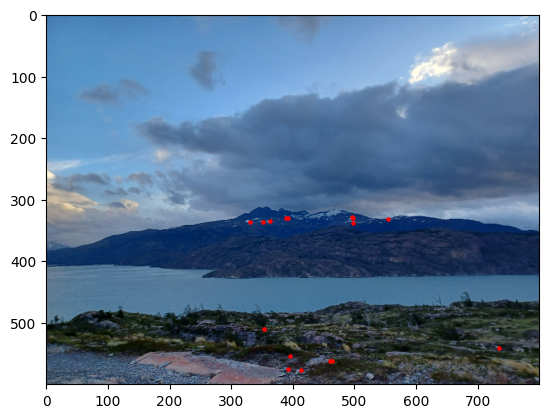

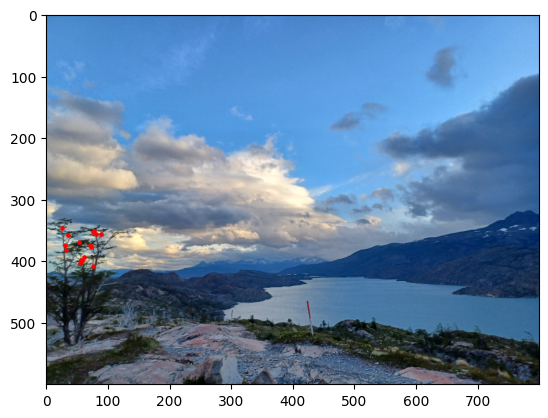

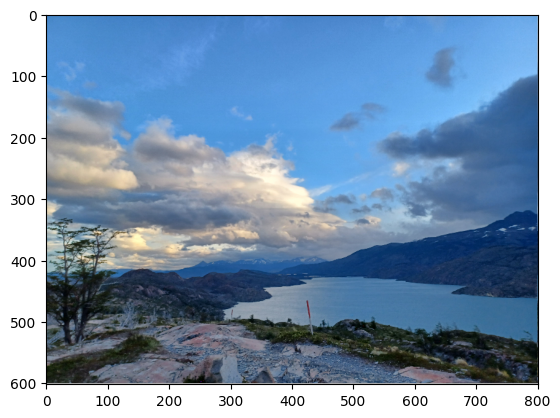

In [616]:
print(coords1ff[:,[1,0]].shape)
ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords1ff[:,[1,0]])
plt.imshow(lake2)
for i in ransac_inliers:
    x, y = coord2f[i]
    plt.scatter(y, x, c='r', s=5)
plt.show()
plt.imshow(lake1)
for i in ransac_inliers:
    x, y = coord1f[i]
    plt.scatter(y, x, c='r', s=5)
plt.show()

im1_out=warp_image(lake1,lake2, ransac_H)


# [:,[1,0]]
plt.imshow(im1_out)

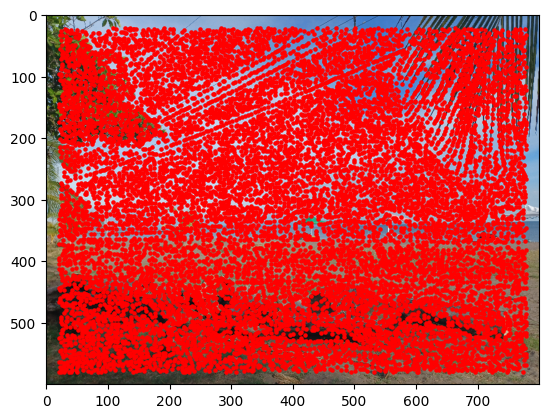

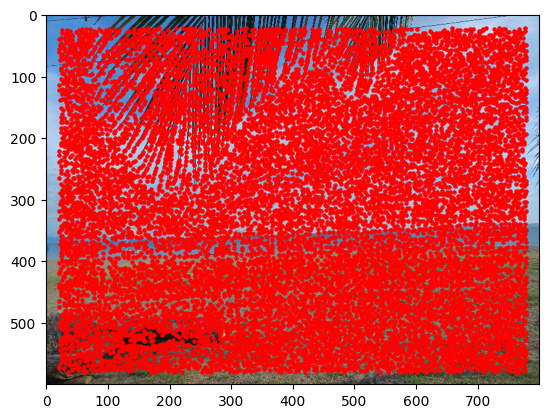

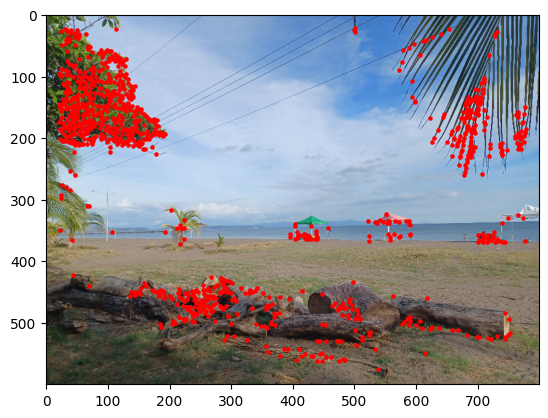

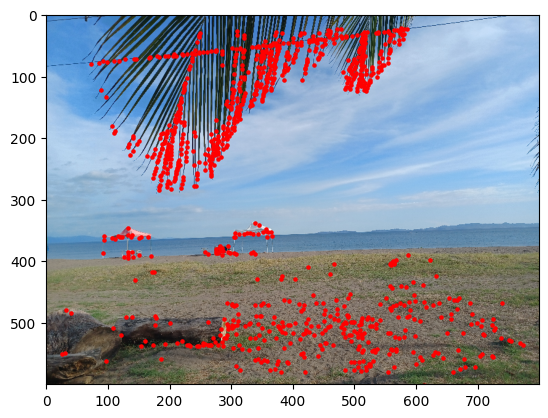

[(274, 63), (397, 344), (493, 108), (927, 729)]


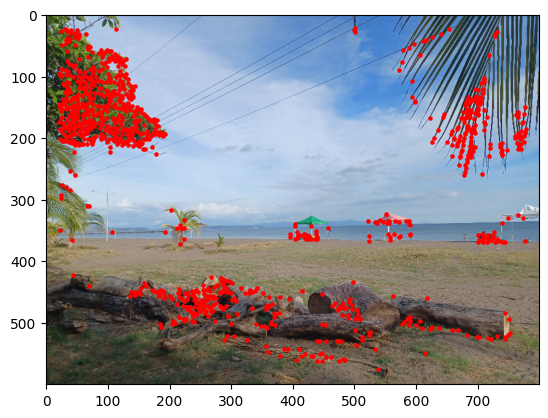

<Figure size 640x480 with 0 Axes>

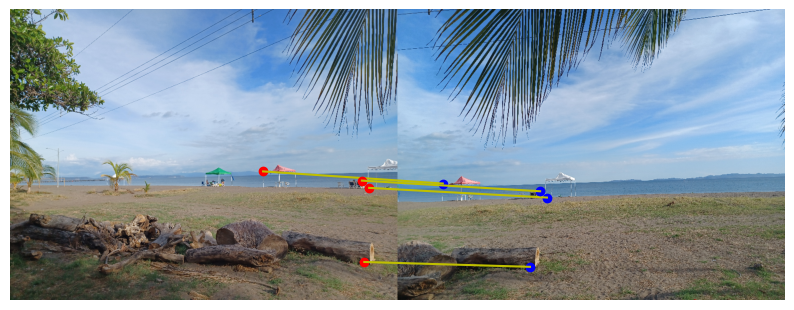

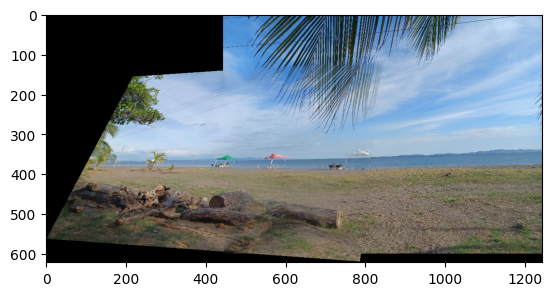

In [682]:
def auto_pano(im1,im2,name):
    harris1, coords1=get_harris_corners(im1[:,:,1],edge_discard=20)
    plt.imshow(im1)
    plt.scatter(coords1[1], coords1[0], c='r', s=5)
    plt.show()
    plt.savefig('{name}_harris1.png')
    harris2, coords2=get_harris_corners(im2[:,:,1], edge_discard=20)
    plt.imshow(im2)
    plt.scatter(coords2[1], coords2[0], c='r', s=5)
    plt.show()
    plt.savefig('{name}_harris2.png')
    ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
    plt.imshow(im1)
    plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
    plt.show()
    plt.savefig('{name}_anms1.png')
    ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
    plt.imshow(im2)
    plt.scatter(ANMS2[:,1],ANMS2[:,0], c='r', s=5)
    plt.show()
    plt.savefig('{name}_anms2.png')
    feat1,coord1f=feature_descr(im1[:,:,1], ANMS1)
    feat2,coord2f=feature_descr(im2[:,:,1], ANMS2)
    matches = feature_match(feat1, feat2, thresh=0.5)
    print(matches)
    plt.imshow(im1)
    plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
    plt.show()
    plt.savefig('{name}_anms1.png')

    matches=np.array(matches)
    # plot_correspondences(im1, im2, coord1f[matches[:4,0]], coord2f[matches[:4,1]],name)
    # print(coord1f[matches[:,0]].shape)
    # coords1ff=coords1ff.T
    # coords2ff=coords2ff.T



    
    coords1ff=coord1f[matches[:,0]]
    coords2ff=coord2f[matches[:,1]]
    # ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords2ff[:,[1,0]])
    im1_out=warp_image(lake1,lake2, computeH(coords1ff[:,[1,0]], coords2ff[:,[1,0]]))

    # im1_out=warp_image(im1,im2, ransac_H)
    plt.imshow(im1_out)
    plt.imsave('{name}_pano.png',im1_out)
    return im1_out

lake1 = skio.imread('beach1.jpg')
lake2 = skio.imread('beach2.jpg')
lake1=cv2.resize(lake1, (800, 600))
lake2=cv2.resize(lake2, (800, 600))
im1=lake1
im2=lake2

harris1, coords1=get_harris_corners(im1[:,:,1],edge_discard=20)
plt.imshow(im1)
plt.scatter(coords1[1], coords1[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris1.png')
harris2, coords2=get_harris_corners(im2[:,:,1], edge_discard=20)
plt.imshow(im2)
plt.scatter(coords2[1], coords2[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris2.png')
ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')
ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
plt.imshow(im2)
plt.scatter(ANMS2[:,1],ANMS2[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms2.png')
feat1,coord1f=feature_descr(im1[:,:,1], ANMS1)
feat2,coord2f=feature_descr(im2[:,:,1], ANMS2)
matches = feature_match(feat1, feat2, thresh=0.5)
print(matches)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')

matches=np.array(matches)
plot_correspondences(im1, im2, coord1f[matches[:10,0]], coord2f[matches[:10,1]])
# print(coord1f[matches[:,0]].shape)
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T




coords1ff=coord1f[matches[:,0]]
coords2ff=coord2f[matches[:,1]]
# ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords2ff[:,[1,0]])
im1_out=warp_image(lake1,lake2, computeH(coords1ff[:10,[1,0]], coords2ff[:10,[1,0]]))

# im1_out=warp_image(im1,im2, ransac_H)
plt.imshow(im1_out)
plt.imsave('{name}_pano.png',im1_out)# plt.imshow(im1_out)

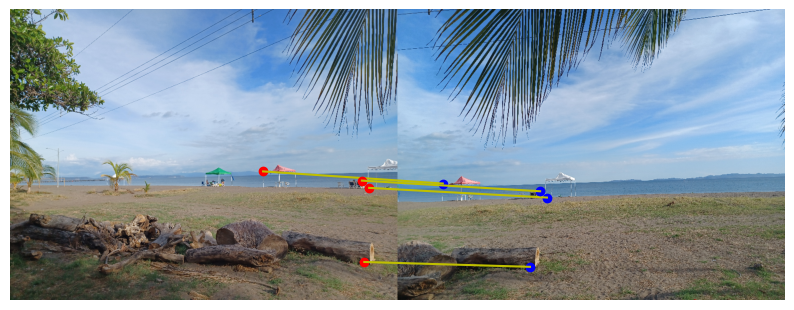

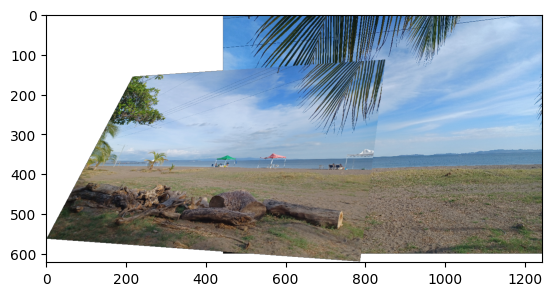

In [648]:
matches=np.array(matches)
plot_correspondences(im1, im2, coord1f[matches[:10,0]], coord2f[matches[:10,1]])
# print(coord1f[matches[:,0]].shape)
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T




coords1ff=coord1f[matches[:,0]]
coords2ff=coord2f[matches[:,1]]
# ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords2ff[:,[1,0]])
im1_out=warp_image(lake1,lake2, computeH(coords1ff[:10,[1,0]], coords2ff[:10,[1,0]]))

# im1_out=warp_image(im1,im2, ransac_H)
plt.imshow(im1_out)
plt.imsave('{name}_pano.png',im1_out)# plt.imshow(im1_out)

(2783, 4000, 3)


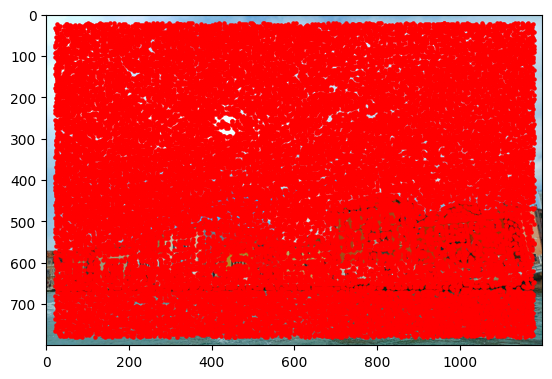

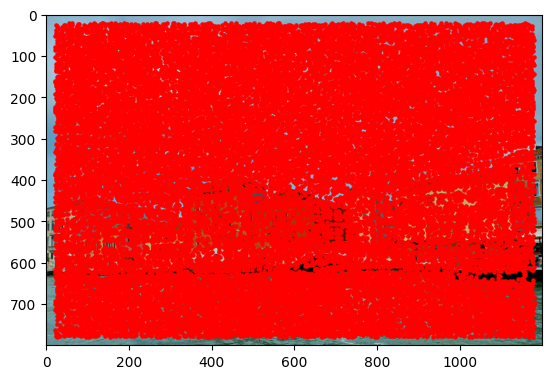

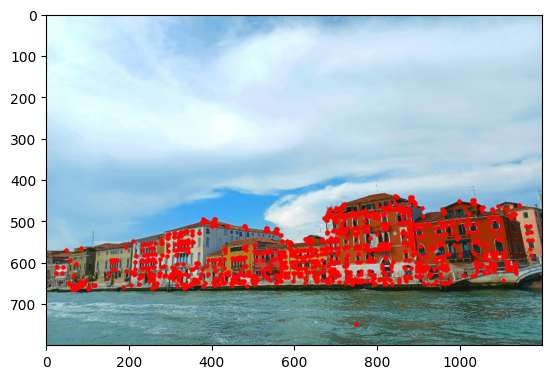

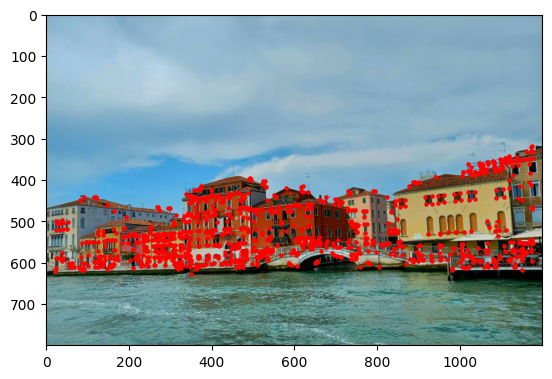

[(1, 131), (11, 231), (12, 2), (23, 82), (62, 164), (76, 52), (91, 35), (96, 140), (113, 395), (156, 47), (198, 53), (200, 297), (238, 933), (270, 562), (296, 658), (305, 195), (324, 993), (344, 198), (473, 68), (521, 850), (651, 752), (664, 161), (949, 942)]


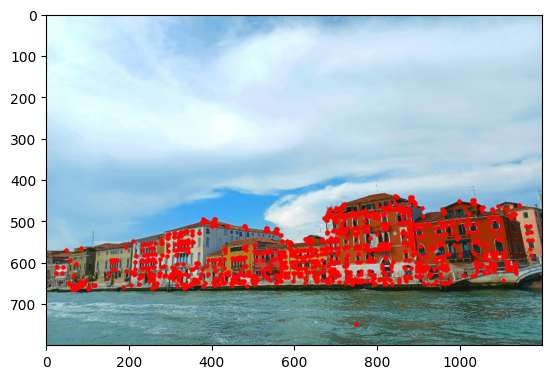

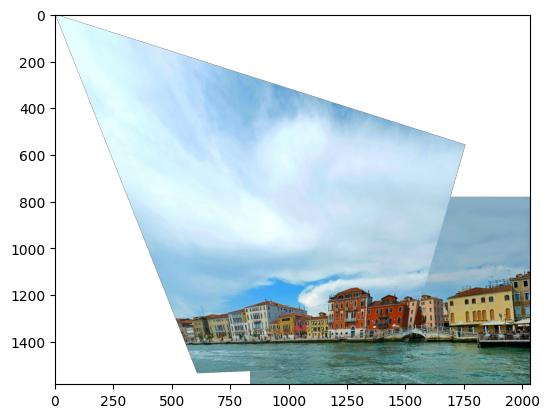

In [641]:

lake1 = skio.imread('houses1.jpg')
lake2 = skio.imread('houses2.jpg')
print(lake1.shape)
lake1=cv2.resize(lake1, (1200, 800))
lake2=cv2.resize(lake2, (1200, 800))

# plt.imshow(lake1)

# lake2=cv2.resize(lake2, (800, 600))
im1_out=auto_pano(lake1,lake2,"beaches")


(2783, 4000, 3)


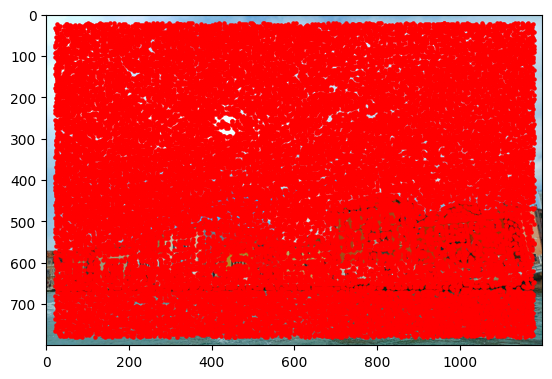

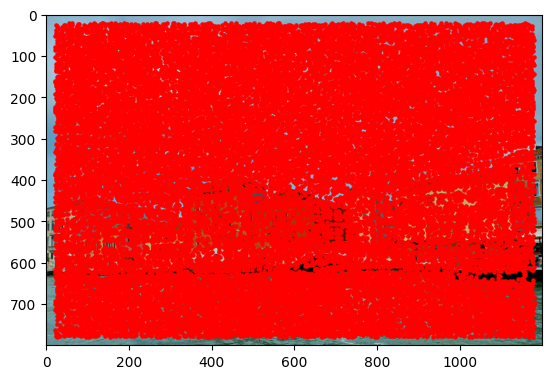

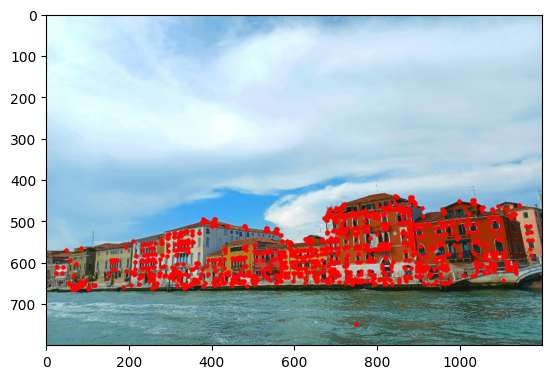

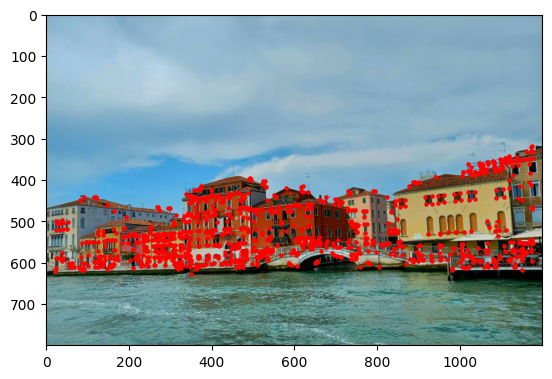

[(1, 131), (11, 231), (12, 2), (23, 82), (47, 133), (62, 164), (76, 52), (91, 35), (96, 140), (97, 535), (113, 395), (114, 154), (116, 57), (125, 269), (156, 47), (183, 423), (198, 53), (200, 297), (225, 33), (238, 933), (270, 562), (296, 658), (304, 307), (305, 195), (317, 376), (324, 993), (344, 198), (397, 387), (414, 432), (421, 568), (473, 68), (497, 98), (521, 850), (612, 501), (615, 881), (630, 414), (651, 752), (664, 161), (687, 87), (691, 671), (753, 158), (781, 912), (851, 741), (927, 755), (949, 942)]


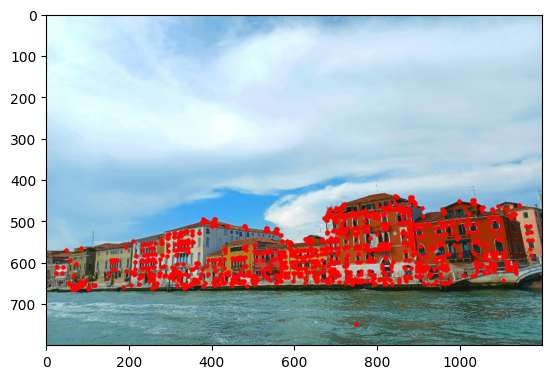

<Figure size 640x480 with 0 Axes>

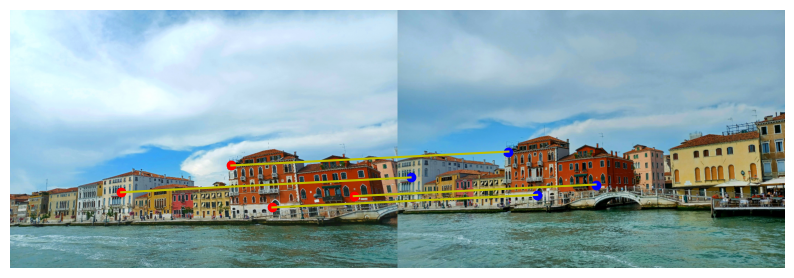

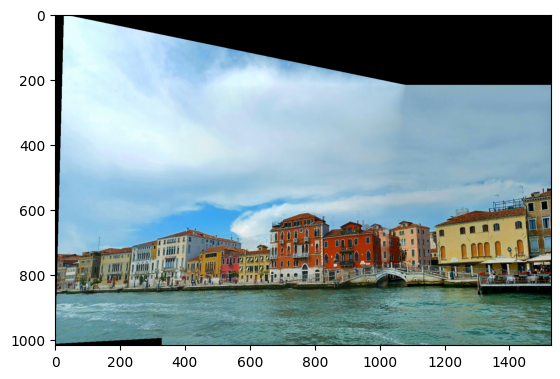

In [698]:

lake1 = skio.imread('houses1.jpg')
lake2 = skio.imread('houses2.jpg')
print(lake1.shape)
lake1=cv2.resize(lake1, (1200, 800))
lake2=cv2.resize(lake2, (1200, 800))
im1=lake1
im2=lake2


harris1, coords1=get_harris_corners(im1[:,:,1],edge_discard=20)
plt.imshow(im1)
plt.scatter(coords1[1], coords1[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris1.png')
harris2, coords2=get_harris_corners(im2[:,:,1], edge_discard=20)
plt.imshow(im2)
plt.scatter(coords2[1], coords2[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris2.png')
ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')
ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
plt.imshow(im2)
plt.scatter(ANMS2[:,1],ANMS2[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms2.png')
feat1,coord1f=feature_descr(im1[:,:,1], ANMS1)
feat2,coord2f=feature_descr(im2[:,:,1], ANMS2)
matches = feature_match(feat1, feat2, thresh=0.6)
print(matches)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')

matches=np.array(matches)
plot_correspondences(im1, im2, coord1f[matches[:4,0]], coord2f[matches[:4,1]])
# print(coord1f[matches[:,0]].shape)
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T




coords1ff=coord1f[matches[:,0]]
coords2ff=coord2f[matches[:,1]]
# ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords2ff[:,[1,0]])
im1_out=warp_image(lake1,lake2, computeH(coords1ff[:4,[1,0]], coords2ff[:4,[1,0]]))

# im1_out=warp_image(im1,im2, ransac_H)
plt.imshow(im1_out)
plt.imsave('{name}_pano.png',im1_out)
# return im1_out

(3000, 4000, 3)


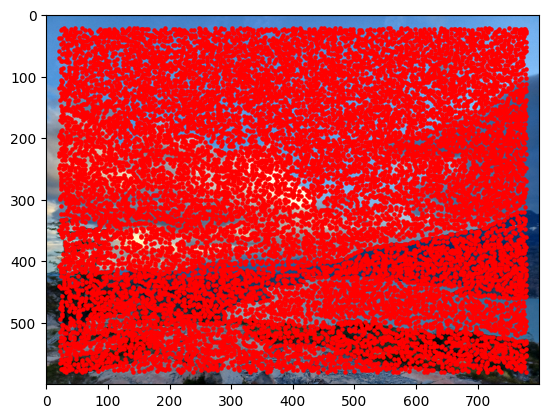

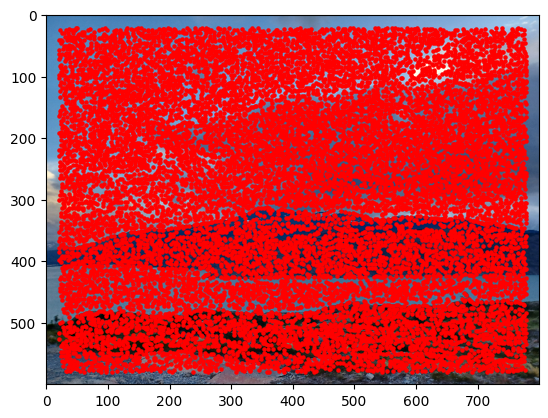

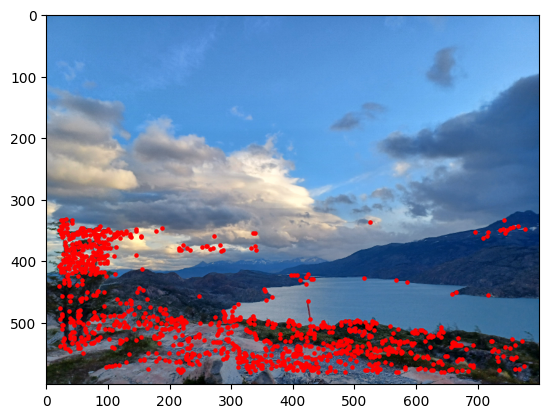

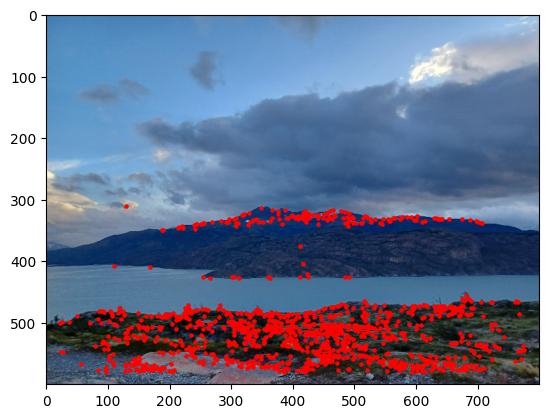

[(202, 57), (268, 19), (300, 477), (334, 446), (375, 152), (418, 817), (588, 298), (688, 951), (719, 828), (745, 762), (761, 143), (815, 762), (831, 546), (971, 181), (973, 948), (983, 768)]


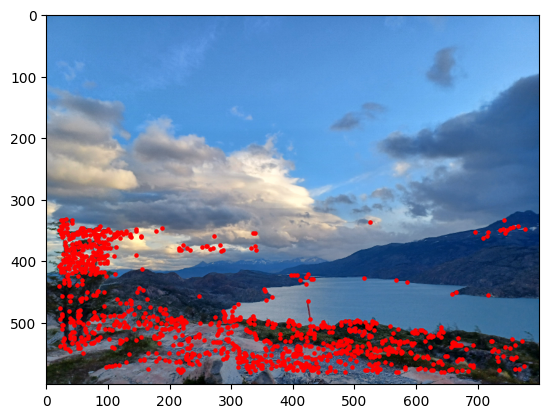

<Figure size 640x480 with 0 Axes>

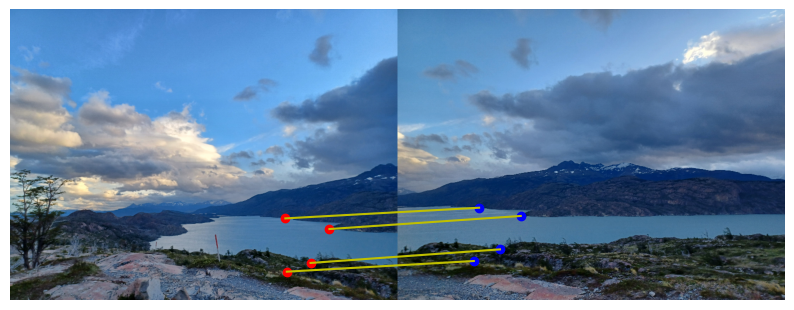

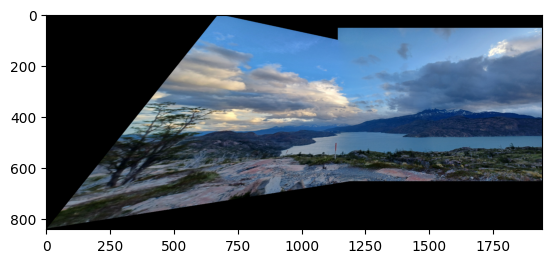

In [692]:

lake1 = skio.imread('lake1.jpg')
lake2 = skio.imread('lake2.jpg')
print(lake1.shape)
lake1=cv2.resize(lake1, (800, 600))
lake2=cv2.resize(lake2, (800, 600))
im1=lake1
im2=lake2


harris1, coords1=get_harris_corners(im1[:,:,1],edge_discard=20)
plt.imshow(im1)
plt.scatter(coords1[1], coords1[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris1.png')
harris2, coords2=get_harris_corners(im2[:,:,1], edge_discard=20)
plt.imshow(im2)
plt.scatter(coords2[1], coords2[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris2.png')
ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')
ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
plt.imshow(im2)
plt.scatter(ANMS2[:,1],ANMS2[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms2.png')
feat1,coord1f=feature_descr(im1[:,:,1], ANMS1)
feat2,coord2f=feature_descr(im2[:,:,1], ANMS2)
matches = feature_match(feat1, feat2, thresh=0.6)
print(matches)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')

matches=np.array(matches)
plot_correspondences(im1, im2, coord1f[matches[:4,0]], coord2f[matches[:4,1]])
# print(coord1f[matches[:,0]].shape)
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T




coords1ff=coord1f[matches[:,0]]
coords2ff=coord2f[matches[:,1]]
# ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords2ff[:,[1,0]])
im1_out=warp_image(lake1,lake2, computeH(coords1ff[:4,[1,0]], coords2ff[:4,[1,0]]))

# im1_out=warp_image(im1,im2, ransac_H)
plt.imshow(im1_out)
plt.imsave('{name}_pano.png',im1_out)
# return im1_out

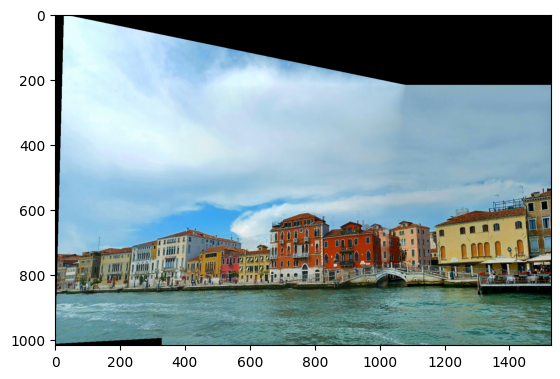

In [681]:
im1_out=warp_image(lake1,lake2, computeH(coords1ff[:4,[1,0]], coords2ff[:4,[1,0]]))

# im1_out=warp_image(im1,im2, ransac_H)
plt.imshow(im1_out)
plt.imsave('{name}_pano.png',im1_out)

(3000, 4000, 3)


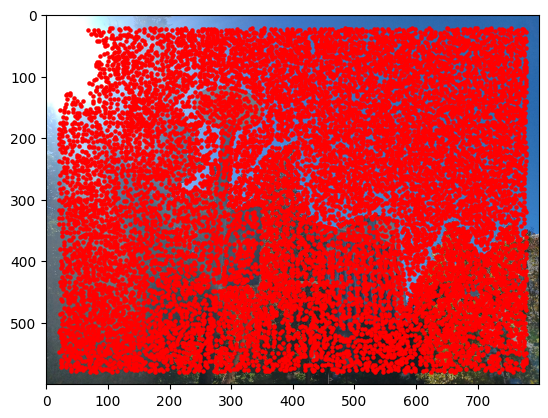

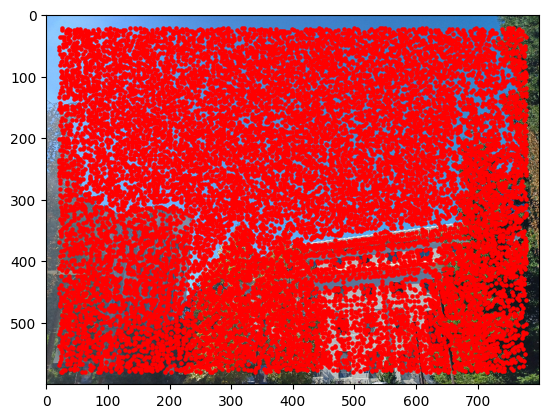

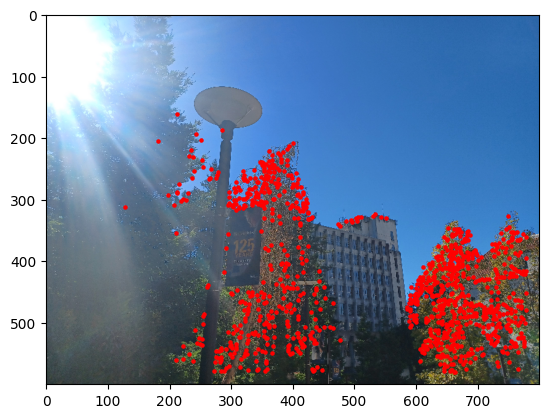

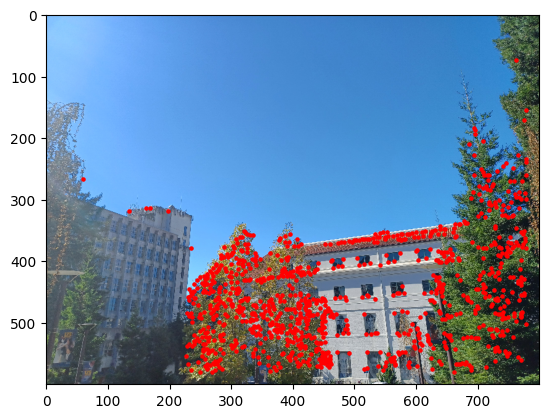

[(24, 211), (43, 128), (79, 30), (183, 515), (208, 341), (233, 440), (256, 242), (366, 524), (488, 774), (733, 912), (735, 775), (838, 16), (978, 327)]


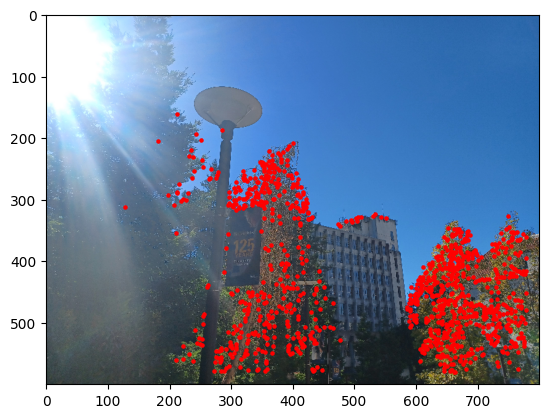

<Figure size 640x480 with 0 Axes>

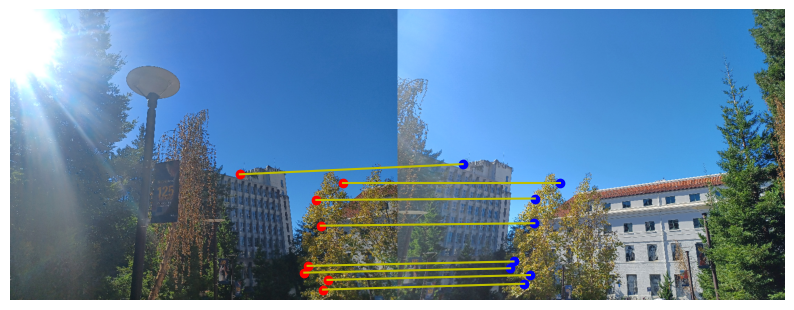

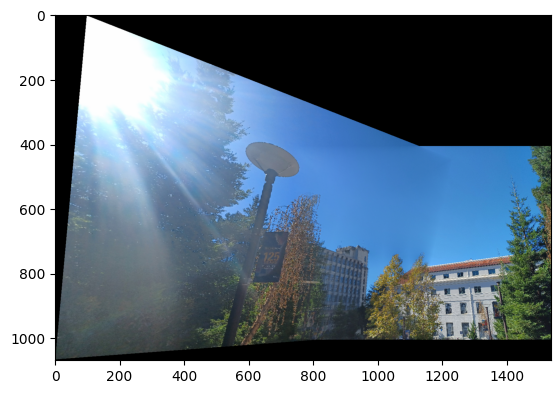

In [689]:

lake1 = skio.imread('build1.jpg')
lake2 = skio.imread('build2.jpg')
print(lake1.shape)
lake1=cv2.resize(lake1, (800, 600))
lake2=cv2.resize(lake2, (800, 600))
im1=lake1
im2=lake2


harris1, coords1=get_harris_corners(im1[:,:,1],edge_discard=20)
plt.imshow(im1)
plt.scatter(coords1[1], coords1[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris1.png')
harris2, coords2=get_harris_corners(im2[:,:,1], edge_discard=20)
plt.imshow(im2)
plt.scatter(coords2[1], coords2[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris2.png')
ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')
ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
plt.imshow(im2)
plt.scatter(ANMS2[:,1],ANMS2[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms2.png')
feat1,coord1f=feature_descr(im1[:,:,1], ANMS1)
feat2,coord2f=feature_descr(im2[:,:,1], ANMS2)
matches = feature_match(feat1, feat2, thresh=0.6)
print(matches)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')

matches=np.array(matches)
plot_correspondences(im1, im2, coord1f[matches[:8,0]], coord2f[matches[:8,1]])
# print(coord1f[matches[:,0]].shape)
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T




coords1ff=coord1f[matches[:,0]]
coords2ff=coord2f[matches[:,1]]
# ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords2ff[:,[1,0]])
im1_out=warp_image(lake1,lake2, computeH(coords1ff[:8,[1,0]], coords2ff[:8,[1,0]]))

# im1_out=warp_image(im1,im2, ransac_H)
plt.imshow(im1_out)
plt.imsave('{name}_pano.png',im1_out)
# return im1_out

(3000, 4000, 3)


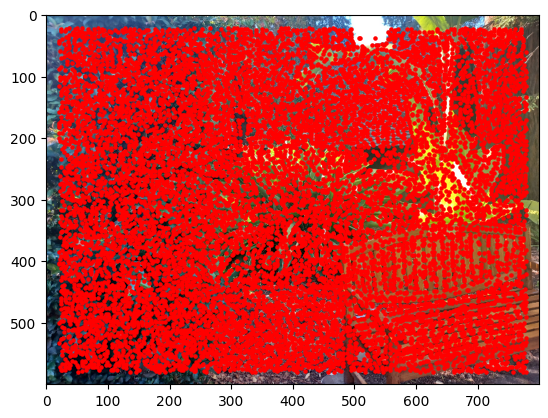

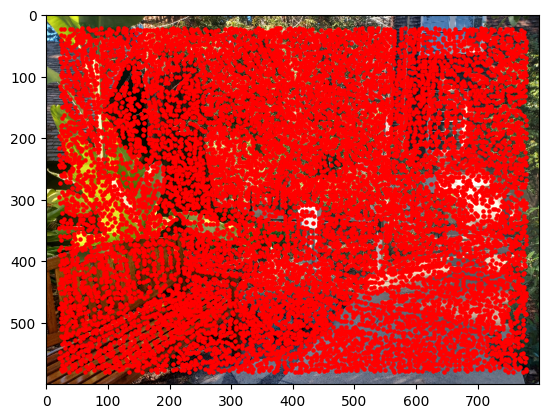

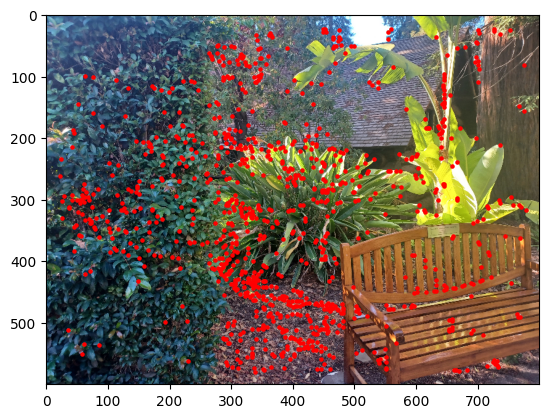

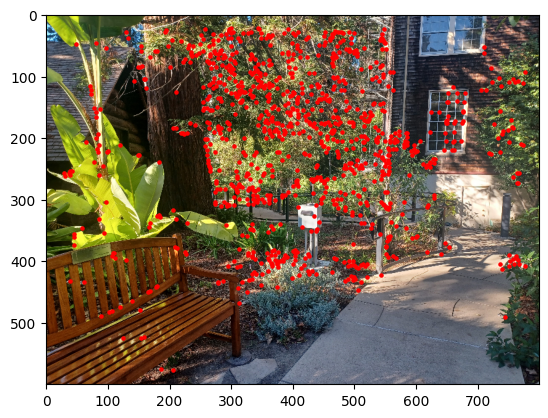

[(104, 412), (115, 953), (187, 795), (200, 965), (286, 403), (325, 355), (442, 268)]


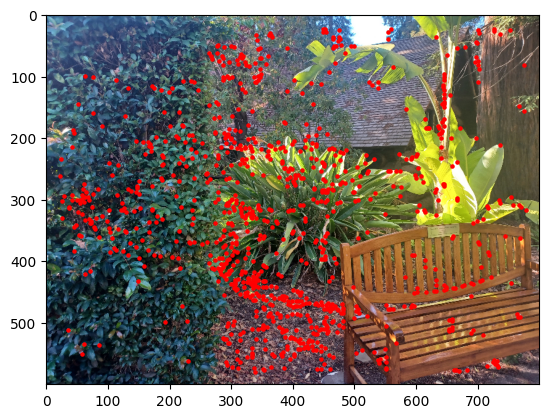

(7, 2)


<Figure size 640x480 with 0 Axes>

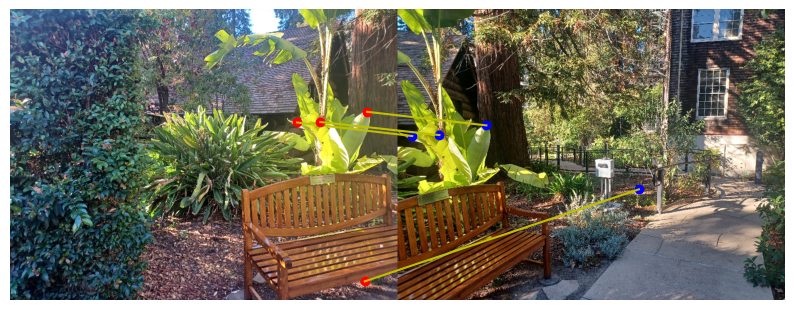

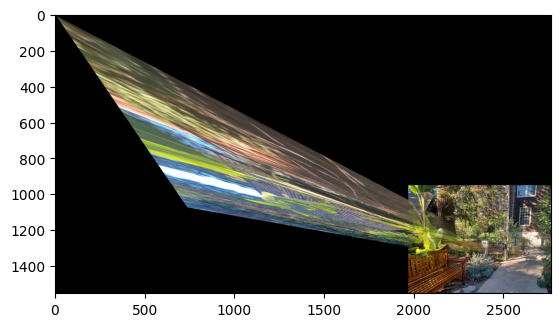

In [697]:

lake1 = skio.imread('bench1.jpg')
lake2 = skio.imread('bench2.jpg')
print(lake1.shape)
lake1=cv2.resize(lake1, (800, 600))
lake2=cv2.resize(lake2, (800, 600))
im1=lake1
im2=lake2


harris1, coords1=get_harris_corners(im1[:,:,1],edge_discard=20)
plt.imshow(im1)
plt.scatter(coords1[1], coords1[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris1.png')
harris2, coords2=get_harris_corners(im2[:,:,1], edge_discard=20)
plt.imshow(im2)
plt.scatter(coords2[1], coords2[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris2.png')
ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')
ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
plt.imshow(im2)
plt.scatter(ANMS2[:,1],ANMS2[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms2.png')
feat1,coord1f=feature_descr(im1[:,:,1], ANMS1)
feat2,coord2f=feature_descr(im2[:,:,1], ANMS2)
matches = feature_match(feat1, feat2, thresh=0.65)
print(matches)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')

matches=np.array(matches)
print(matches.shape)
plot_correspondences(im1, im2, coord1f[matches[1:5,0]], coord2f[matches[1:5,1]])
# print(coord1f[matches[:,0]].shape)
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T




coords1ff=coord1f[matches[:,0]]
coords2ff=coord2f[matches[:,1]]
# ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords2ff[:,[1,0]])
im1_out=warp_image(lake1,lake2, computeH(coords1ff[1:5,[1,0]], coords2ff[1:5,[1,0]]))

# im1_out=warp_image(im1,im2, ransac_H)
plt.imshow(im1_out)
plt.imsave('{name}_pano.png',im1_out)
# return im1_out

(3000, 4000, 3)


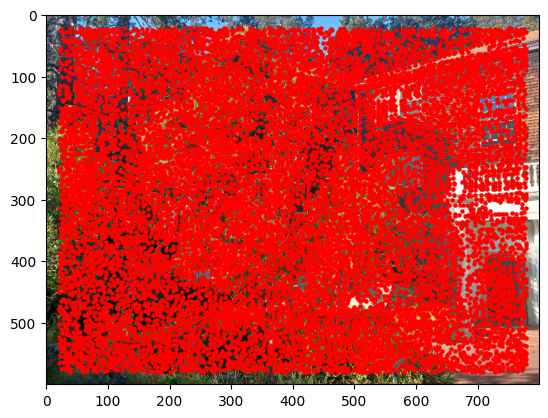

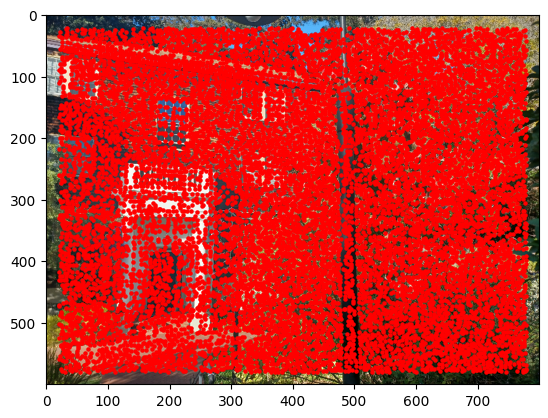

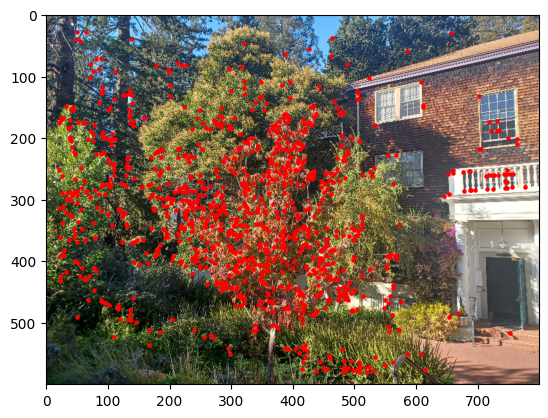

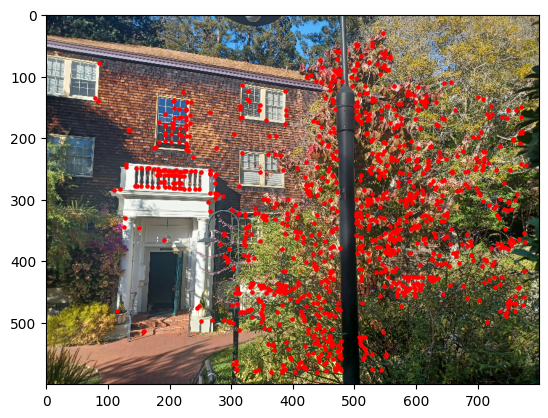

[(88, 30), (166, 869), (180, 13), (722, 986), (860, 374), (862, 10)]


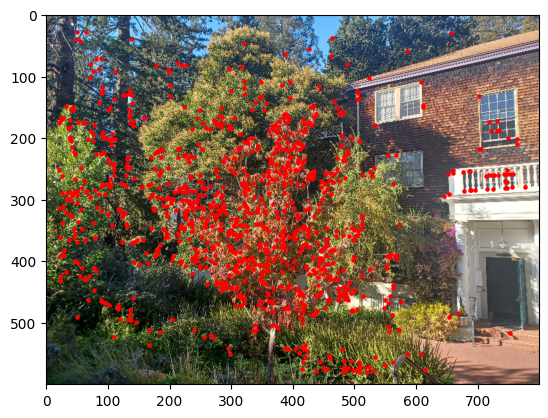

<Figure size 640x480 with 0 Axes>

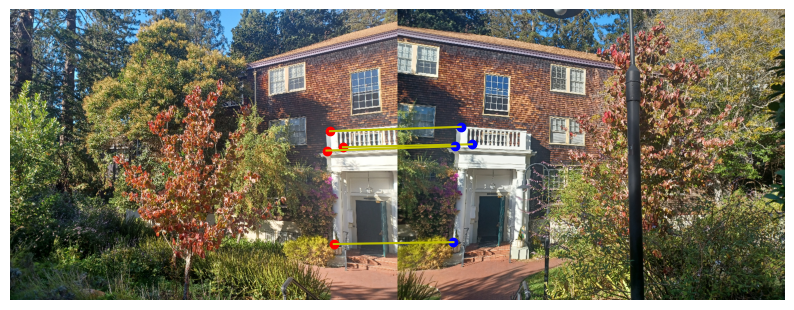

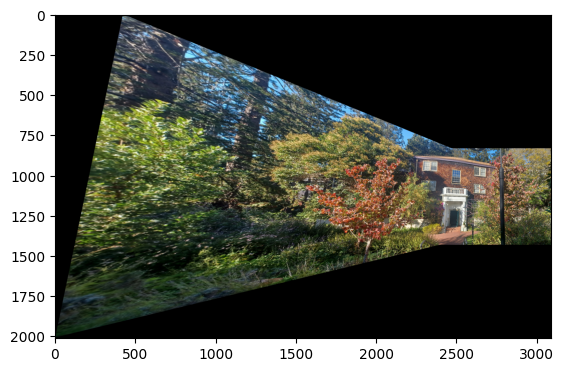

In [685]:

lake1 = skio.imread('womens1.jpg')
lake2 = skio.imread('womens2.jpg')
print(lake1.shape)
lake1=cv2.resize(lake1, (800, 600))
lake2=cv2.resize(lake2, (800, 600))
im1=lake1
im2=lake2


harris1, coords1=get_harris_corners(im1[:,:,1],edge_discard=20)
plt.imshow(im1)
plt.scatter(coords1[1], coords1[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris1.png')
harris2, coords2=get_harris_corners(im2[:,:,1], edge_discard=20)
plt.imshow(im2)
plt.scatter(coords2[1], coords2[0], c='r', s=5)
plt.show()
plt.savefig('{name}_harris2.png')
ANMS1 = adaptive_non_maximal_suppression(harris1[coords1[0], coords1[1]], coords1.T, 1000)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')
ANMS2 = adaptive_non_maximal_suppression(harris2[coords2[0], coords2[1]], coords2.T, 1000)
plt.imshow(im2)
plt.scatter(ANMS2[:,1],ANMS2[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms2.png')
feat1,coord1f=feature_descr(im1[:,:,1], ANMS1)
feat2,coord2f=feature_descr(im2[:,:,1], ANMS2)
matches = feature_match(feat1, feat2, thresh=0.5)
print(matches)
plt.imshow(im1)
plt.scatter(ANMS1[:,1],ANMS1[:,0], c='r', s=5)
plt.show()
plt.savefig('{name}_anms1.png')

matches=np.array(matches)
plot_correspondences(im1, im2, coord1f[matches[:4,0]], coord2f[matches[:4,1]])
# print(coord1f[matches[:,0]].shape)
# coords1ff=coords1ff.T
# coords2ff=coords2ff.T




coords1ff=coord1f[matches[:,0]]
coords2ff=coord2f[matches[:,1]]
# ransac_H, ransac_inliers = ransac(coords1ff[:,[1,0]], coords2ff[:,[1,0]])
im1_out=warp_image(lake1,lake2, computeH(coords1ff[:4,[1,0]], coords2ff[:4,[1,0]]))

# im1_out=warp_image(im1,im2, ransac_H)
plt.imshow(im1_out)
plt.imsave('{name}_pano.png',im1_out)
# return im1_out